Anthony Decron et Remi Fourcroy

In [1]:
import skimage.io as io 
import matplotlib.pyplot as plt
import skimage as sk
import skimage.color as clr
import matplotlib as mat
import numpy as np
import scipy as sc
import glob
from skimage.filters import try_all_threshold #fonction pour tester une grande variété de fonction pour le threshold d'un coup.

mat.rc('image', cmap='gray')

# Introduction du sujet

L'objectif ici est de compter le nombre de nœuds sur le bois. Pour cela, nous allons, dans un premier temps, utiliser une méthode élémentaire et discuter de ses avantages et de ses inconvénients. L'objectif est ensuite, à l'aide de publications scientifiques et de notre propre intuition scientifique, d'améliorer cette méthode pour la rendre la plus précise possible.

nombre d'images 8


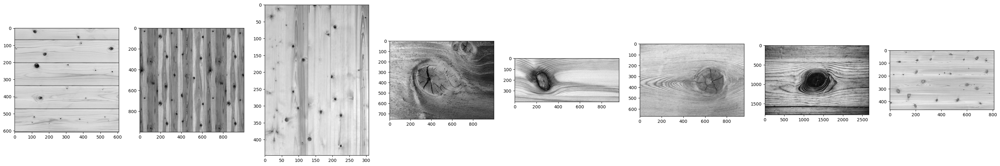

In [2]:
data = glob.glob('dataset/*.jpg') #le chemin pour accéder aux image

data_size = len(data) #Le nombre d'images

#Déclaration de toute les listes que nous utiliseront dans la suite. Toute les images sont stockées dans des listes pour être réutilisées à tout moment
#ce n'est pas le plus optimiser pour la géstion de mémoire nous pourrions clear toute liste après utilisation. Ici nous ne le faisons pas car nous pourrions en avoir besoin
#pour diverses comparaisons ou autre.
data_gray = [None] * data_size
data_threshold = [None] * data_size
data_threshold2 = [None] * data_size
data_fill = [None] * data_size
data_fill2 = [None] * data_size
noise_data_t = [None] * data_size
data_float = [None] * data_size
t_test = [None] * data_size
data_brown = [None] * data_size

print("nombre d'images",data_size)

fig, ax = plt.subplots(1, data_size,figsize = (40,40))

#Conversion et stockage des images passées en noir et blanc.
for i in range(data_size):
    data_gray[i] = clr.rgb2gray(io.imread(data[i]))
    ax[i].imshow((data_gray[i]),cmap = 'gray')

# Traitement des images
Ici nous utilisons une technique basique pour le thresholding, qui consiste à prendre la moyenne des intensités sur les images en noir et blanc comme seuil.

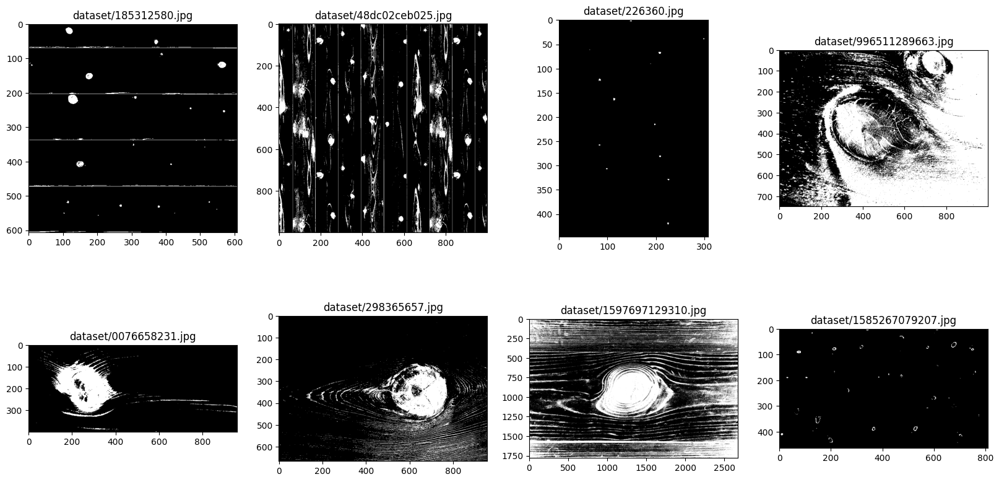

In [3]:
fig, ax = plt.subplots(2, 4,figsize = (20,10))
for i in range(data_size):
    data_mean= np.max(data_gray[i])/2
    data_threshold[i] = data_gray[i] < data_mean
    ax.flatten()[i].imshow((data_threshold[i]),cmap = 'gray')
    ax.flatten()[i].set_title((data[i]))
    


Ces images contenant des trous imparfaits vont ensuite être traités pour remplir tout ces trous.

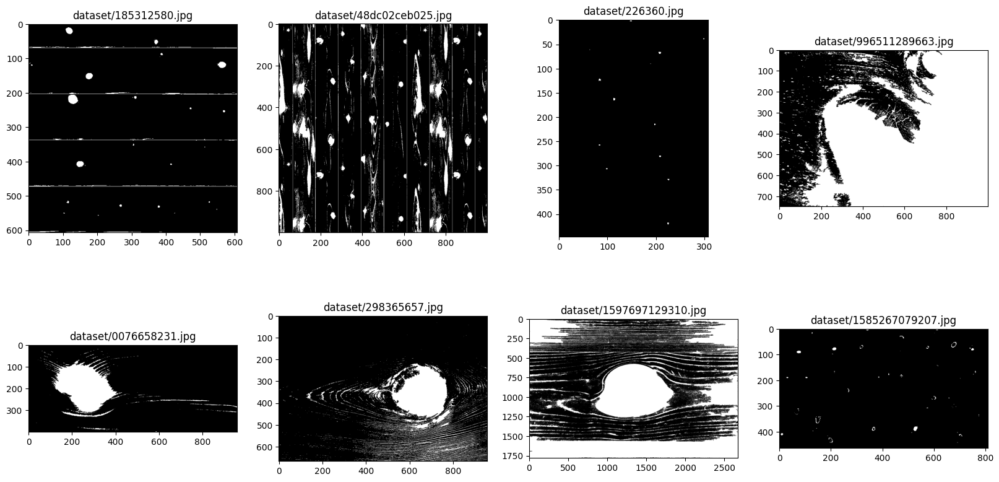

In [4]:
fig, ax = plt.subplots(2, 4,figsize = (20,10))

for i in range(data_size):
    data_fill[i] = sc.ndimage.binary_fill_holes(data_threshold[i]) #Ceci est la fonction qui remplit les trous
    ax.flatten()[i].imshow((data_fill[i]),cmap = 'gray')
    ax.flatten()[i].set_title((data[i]))

Les régions qui nous restes ne sont pas tous des noueds on peux donc les filtrer. C'est l'objectif du prochain code qui filtre les objets avec les conditions suivantes : On ne garde que les régions qui on plus de 5 pixel pour ainsi ne pas garder les régions trop petite et on retire toute les régions avec une excentricité supérieur à 0.9 ce qui nous retira toute les régions trop longue.

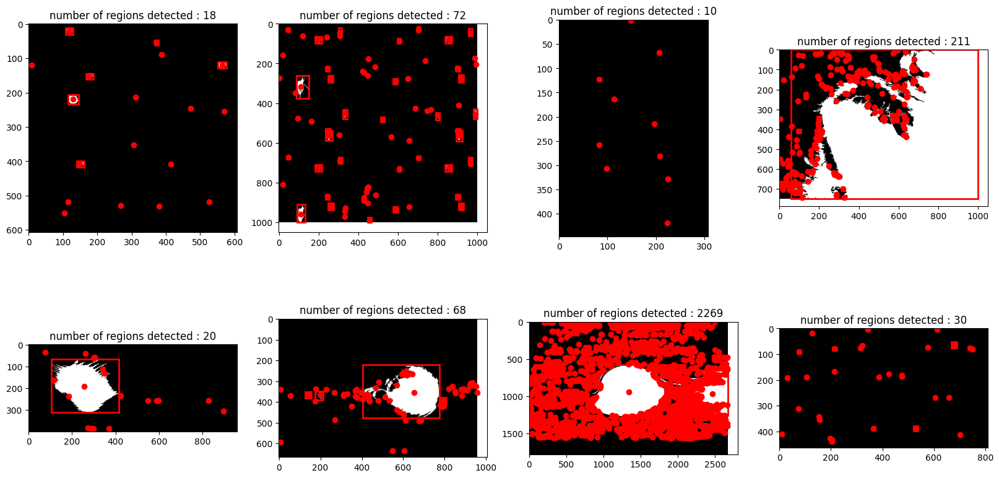

In [5]:
fig, ax = plt.subplots(2, 4,figsize = (20,10))

for i in range(data_size):
    labeled_regions, num_labels = sk.measure.label(data_fill[i], return_num=True) #Ici on récupère toutes les régions connecté et le nombre de régions
    
    region_props = sk.measure.regionprops(labeled_regions) # Ici on récupère les différentse informations des régions utiles pour le filtrage. 
    
    filtered_regions = [
        region.label
        for region in region_props
        if region.area > 5 and region.eccentricity < 0.9
    ] #ici on garde dans une liste toutes les régions avec les paramètres filtrage expliqués plus haut.
    
    #Ces deux listes sont les centroids et les bounding_boxes des régions qui nous intéréssent après filtrage
    centroids = [region.centroid 
                 for region in region_props
                 if region.area > 5 and region.eccentricity < 0.9]
    bounding_boxes = [region.bbox 
                      for region in region_props
                      if region.area > 5 and region.eccentricity < 0.9]
    
    filtered_image = np.isin(labeled_regions, filtered_regions)#Cette ligne permet de garder uniquement les régions filtrées dans nos images.

    #Ici on affiche les images filtrées avec les centroids, bounding_boxes des régions et le nombre de régions trouvées dans chaque image
    ax.flatten()[i].imshow(filtered_image, cmap='gray')
    ax.flatten()[i].set_title(f"number of regions detected : {len(filtered_regions)}")
    for centroid, bbox in zip(centroids, bounding_boxes):
                y, x = centroid
                minr, minc, maxr, maxc = bbox
                rect = plt.Rectangle((minc, minr), maxc - minc, maxr - minr, fill=False, edgecolor='red', linewidth=2)
                ax.flatten()[i].add_patch(rect)
                ax.flatten()[i].plot(x, y, 'ro')


# Conclusion sur la méthode utilisée
Une fois toute la méthode implémentée, nous remarquons beaucoup d'erreurs. Néanmoins, ces erreurs sont pour la plupart des faux positifs, ce qui signifie que nous trouvons bien les nœuds que nous voulons, mais nous en repérons aussi beaucoup qui n'en sont pas. (On le remarque beaucoup sur les images avec un seul gros nœud, notamment l'image 7 ici.) Ceci pourrait venir d'un mauvais filtrage ou de mauvais paramètres de thresholding.

Nous pouvons facilement voir, dans un premier temps, que le threshold que l'on effectue n'est pas optimisé. Essayons des méthodes d'optimisation (mais en gardant le filtrage identique) pour améliorer ce point.

Nous pouvons aussi, comme dans le LAB7, filtrer les images avant d'effectuer le threshold. C'est-à-dire augmenter le gamma ou d'autres paramètres pour essayer d'isoler les nœuds dans un premier temps.

Pour résumer rapidement, l'objectif final serait d'obtenir la ground-truth de chaque image.

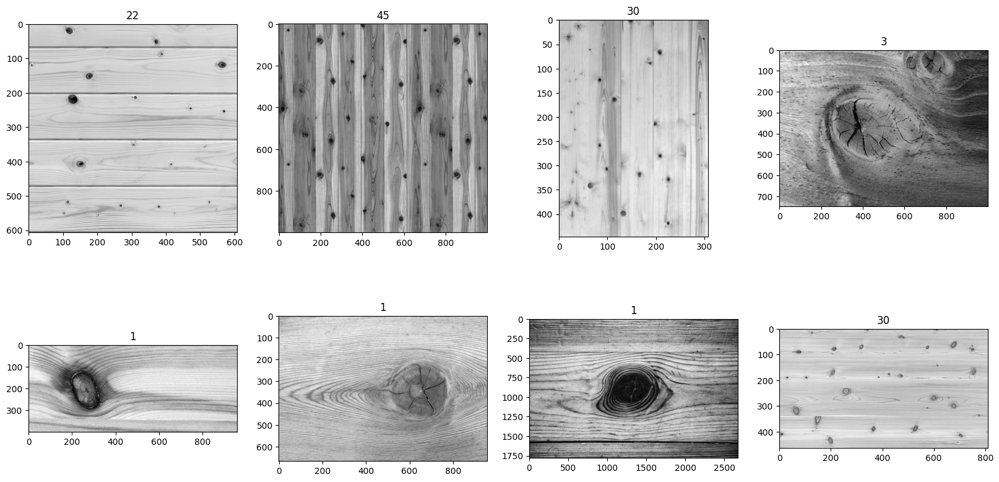

In [6]:
#Ici on affiche juste chaque image avec le nombre de noeuds exact (compter à la main il n'est pas impossible que nous ayons des erreurs)
data_true = [None] * data_size
data_true[0] = 22
data_true[1] = 45
data_true[2] = 30
data_true[3] = 3
data_true[4] = 1
data_true[5] = 1
data_true[6] = 1
data_true[7] = 30
fig, ax = plt.subplots(2, 4,figsize = (20,10))
for i in range(data_size):
    ax.flatten()[i].imshow((data_gray[i]),cmap = 'gray')
    ax.flatten()[i].set_title((data_true[i]))

# Recherche pour l'amélioration de la détection des noeuds
On peut donc avoir une vague idée de la performance de notre méthode en comparant le nombre de nœuds trouvés. On peut déjà constater que notre méthode est efficace sur des images avec des couleurs uniformes et des nœuds de taille moyenne. En revanche, elle a des problèmes lors des grandes variations de couleur et pour les gros nœuds. On peut vérifier cela en appliquant du bruit ou divers changements à nos images. Pour cela, je vais utiliser la dernière image, car c'est avec elle que nous avons la plus grande précision (en nombre, pour la position des nœuds, c'est autre chose).

In [7]:
SNR = 90
for i in range(data_size):
    data_float[i] = data_gray[i].astype(float)
    ps = np.linalg.norm(data_float[i])**2/(data_float[i].shape[0]*data_float[i].shape[1])
    var = pow(10,(-SNR/10)) * ps
    noise_data_t[i] = sk.util.random_noise(data_float[i], clip='False',var = var )

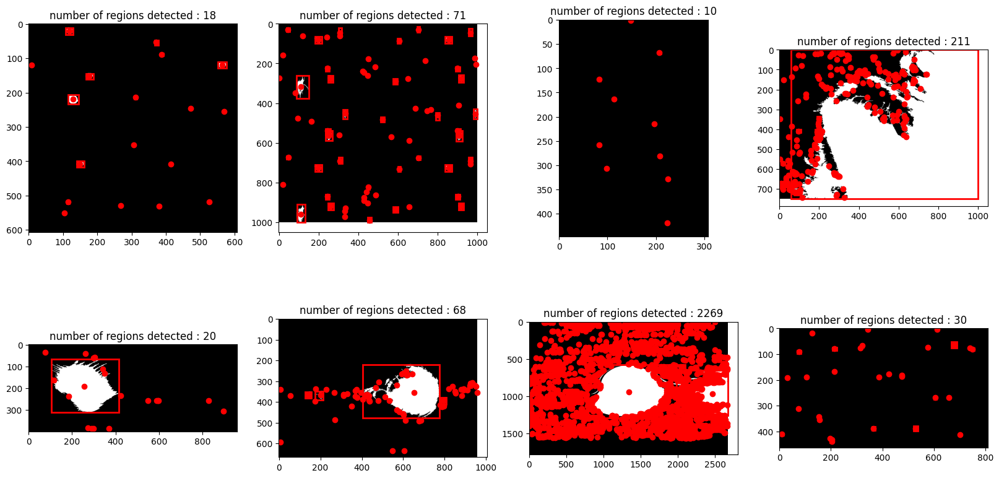

In [8]:
fig, ax = plt.subplots(2, 4,figsize = (20,10))

for i in range(data_size):
    data_mean= np.max(noise_data_t[i])/2
    data_threshold[i] = noise_data_t[i] < data_mean
    data_fill[i] = sc.ndimage.binary_fill_holes(data_threshold[i])
    
    labeled_regions, num_labels = sk.measure.label(data_fill[i], return_num=True)
    
    region_props = sk.measure.regionprops(labeled_regions)
    
    filtered_regions = [
        region.label
        for region in region_props
        if region.area > 5 and region.eccentricity < 0.9
    ]
    
    centroids = [region.centroid 
                 for region in region_props
                 if region.area > 5 and region.eccentricity < 0.9]
    bounding_boxes = [region.bbox 
                      for region in region_props
                      if region.area > 5 and region.eccentricity < 0.9]
    
    filtered_image = np.isin(labeled_regions, filtered_regions)

    
    ax.flatten()[i].imshow(filtered_image, cmap='gray')
    ax.flatten()[i].set_title(f"number of regions detected : {len(filtered_regions)}")
    for centroid, bbox in zip(centroids, bounding_boxes):
                y, x = centroid
                minr, minc, maxr, maxc = bbox
                rect = plt.Rectangle((minc, minr), maxc - minc, maxr - minr, fill=False, edgecolor='red', linewidth=2)
                ax.flatten()[i].add_patch(rect)
                ax.flatten()[i].plot(x, y, 'ro')


On remarque ici que le bruit n'a pas une très grande influence sur le nombre de nœuds détectés. En revanche, si l'on revient au début de la méthode, on remarque que le thresholding pose déjà un problème avec la méthode utilisée. En effet, il laisse même après le tri des régions des points d'intérêt qui ne sont pas des nœuds. On peut donc, dans un premier temps, essayer de garder le filtrage que l'on a, mais changer la méthode de thresholding. Pour ce faire, je vais utiliser une fonction qui teste une variété de méthodes pour le thresholding. Pour cela, on utilisera la fonction [try_all_threshold](https://scikit-image.org/docs/stable/api/skimage.filters.html#skimage.filters.try_all_threshold)."

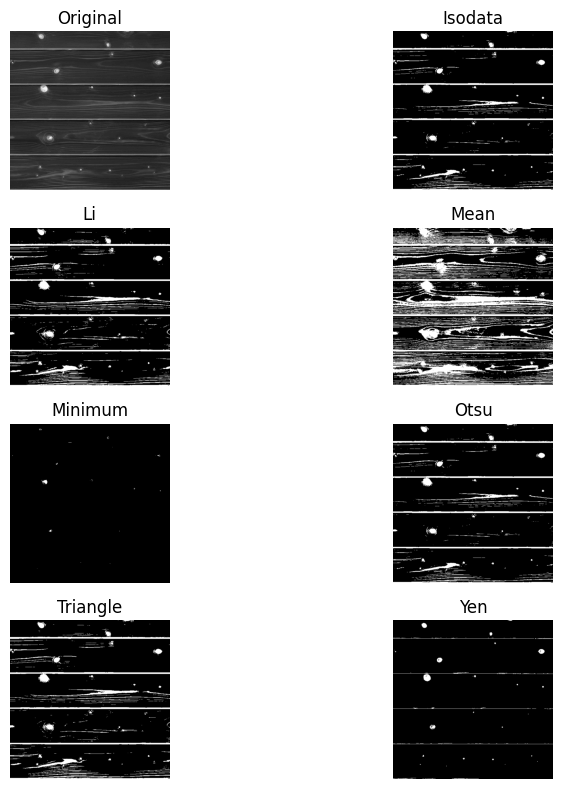

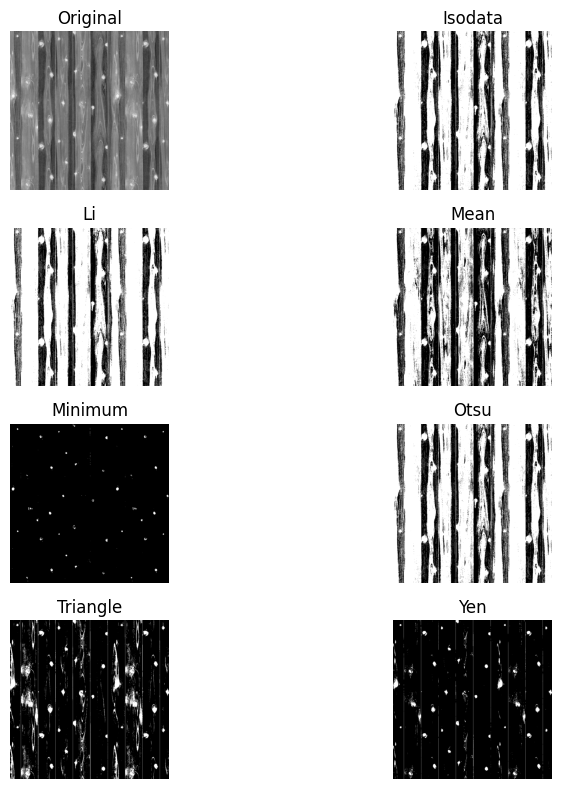

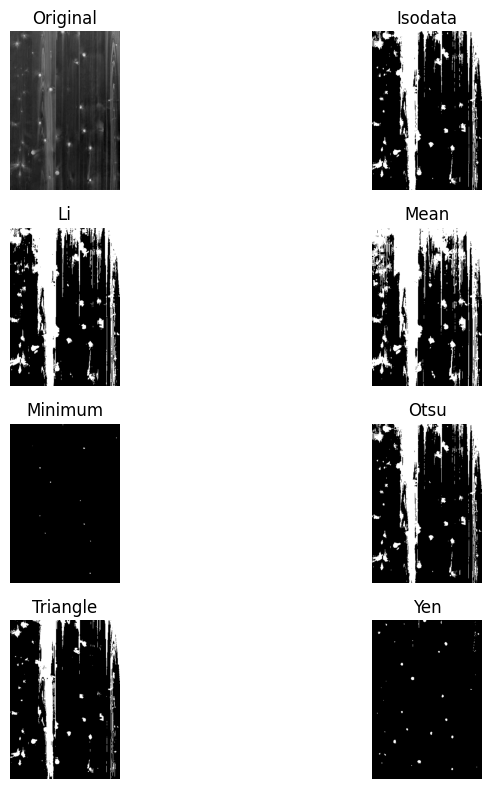

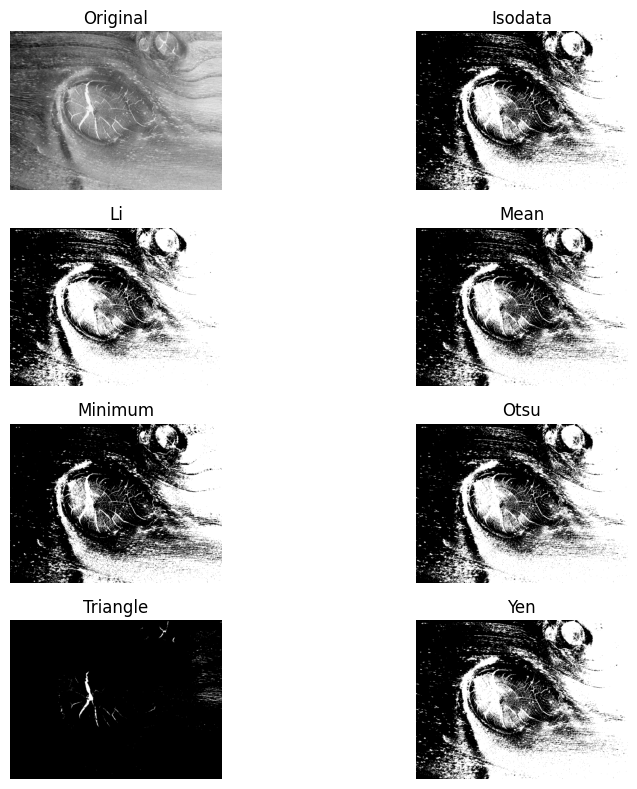

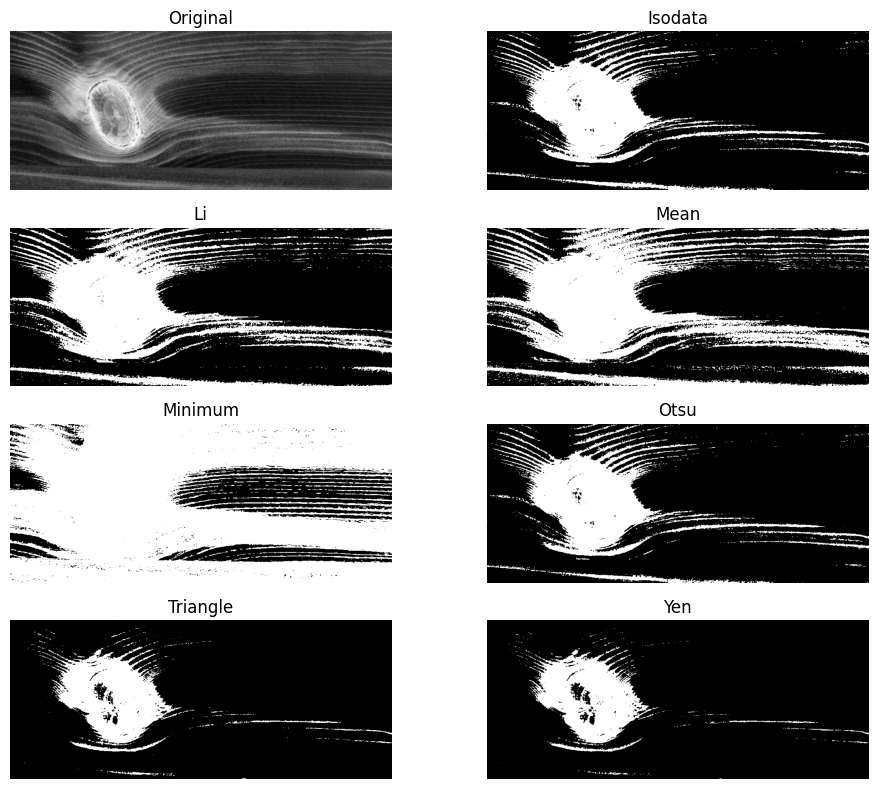

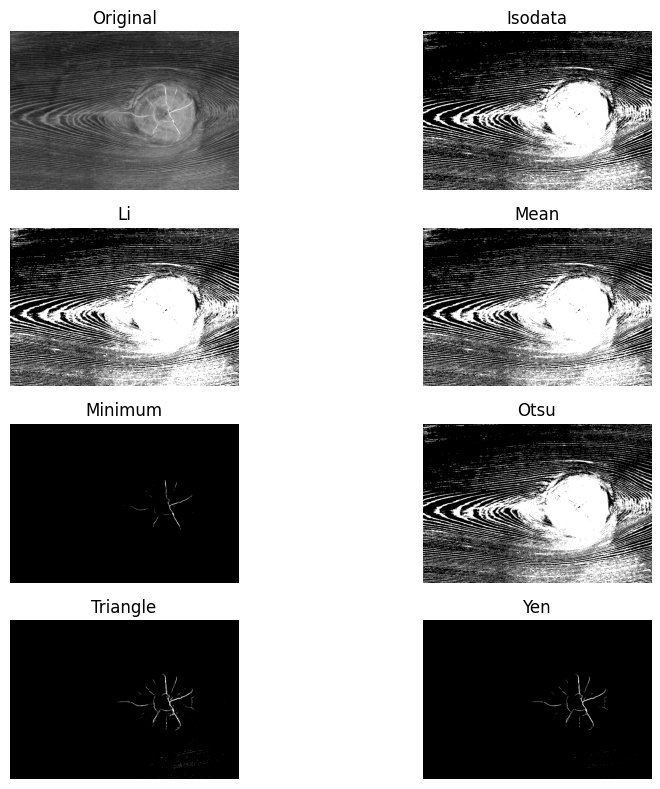

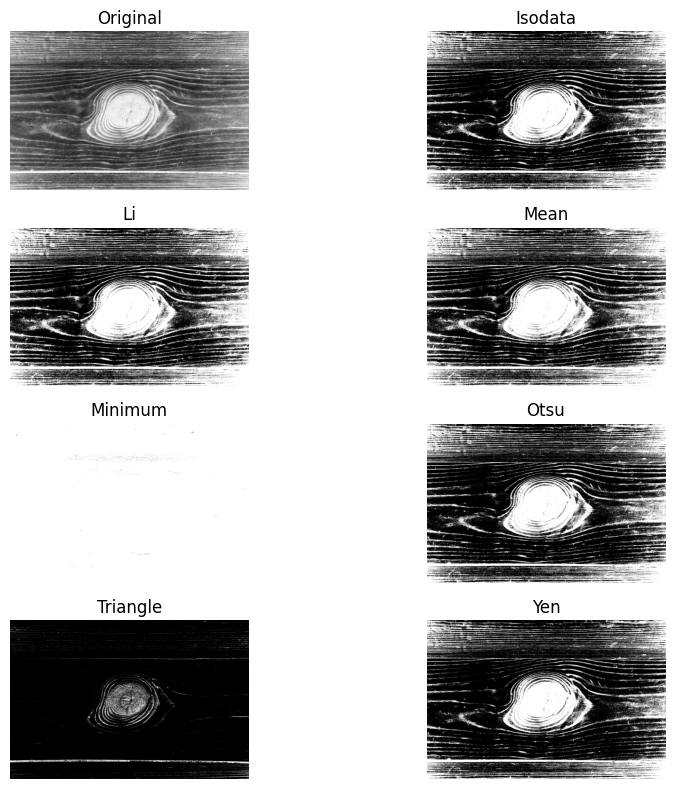

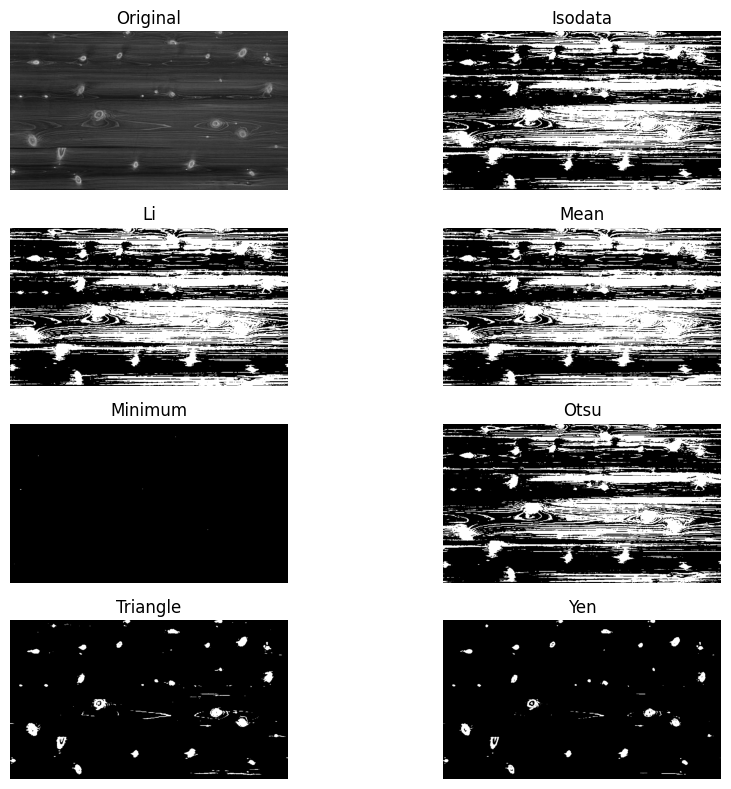

In [9]:
#Ici j'utilise une fonction pour tester plusiseurs méthodes d'optimisation du thresholding pour ensuite en déduire la quel serait la plus optimiser pour chaque image
for i in range(data_size):
    fig, ax = try_all_threshold(1-data_gray[i], figsize=(10, 8), verbose=False) 

On remarque dès lors que chaque image a une méthode différente qui fonctionne au mieux sur elle. Je vais donc, dans un premier temps, utiliser les bonnes fonctions sur les bonnes images pour récupérer les bons seuils.

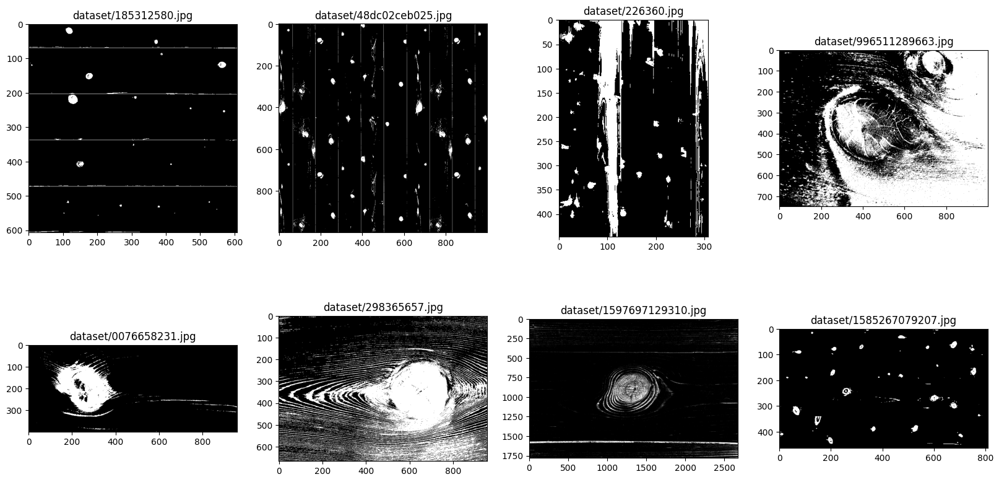

In [10]:
#Ici je mets dans une liste toutes les images avec leur méthode de thresholding associée.
t_test[0] = sk.filters.threshold_yen(data_gray[0])
t_test[1] = sk.filters.threshold_yen(data_gray[1])
t_test[2] = sk.filters.threshold_triangle(data_gray[2])
t_test[3] = sk.filters.threshold_yen(data_gray[3])
t_test[4] = sk.filters.threshold_yen(data_gray[4])
t_test[5] = sk.filters.threshold_otsu(data_gray[5])
t_test[6] = sk.filters.threshold_minimum(data_gray[6])
t_test[7] = sk.filters.threshold_yen(data_gray[7])

fig, ax = plt.subplots(2, 4,figsize = (20,10))

for i in range(data_size):
    data_threshold2[i] = data_gray[i] < t_test[i]
    ax.flatten()[i].imshow((data_threshold2[i]),cmap = 'gray')
    ax.flatten()[i].set_title((data[i]))


On rapplique ensuite les mêmes étapes qu'avec la première méthode

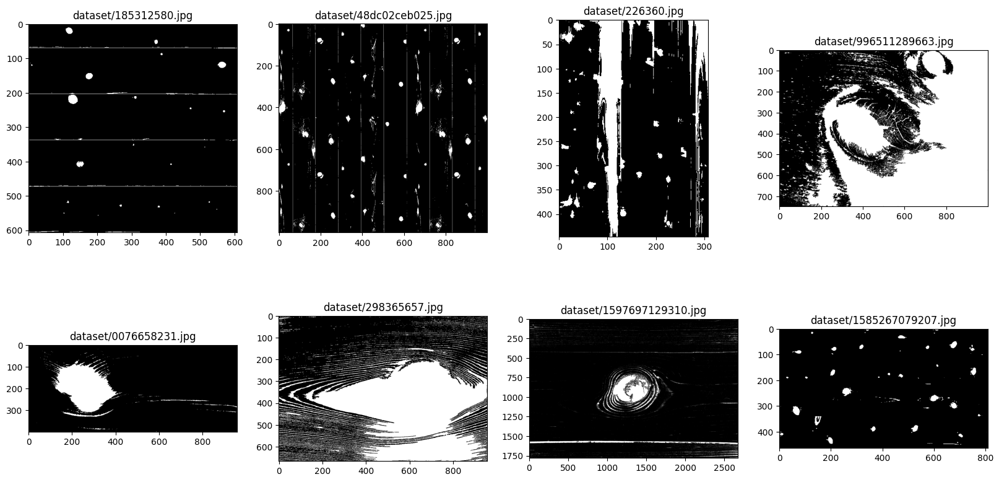

In [11]:
fig, ax = plt.subplots(2, 4,figsize = (20,10))
for i in range(data_size):
    data_fill2[i] = sc.ndimage.binary_fill_holes(data_threshold2[i])
    ax.flatten()[i].imshow((data_fill2[i]),cmap = 'gray')
    ax.flatten()[i].set_title((data[i]))

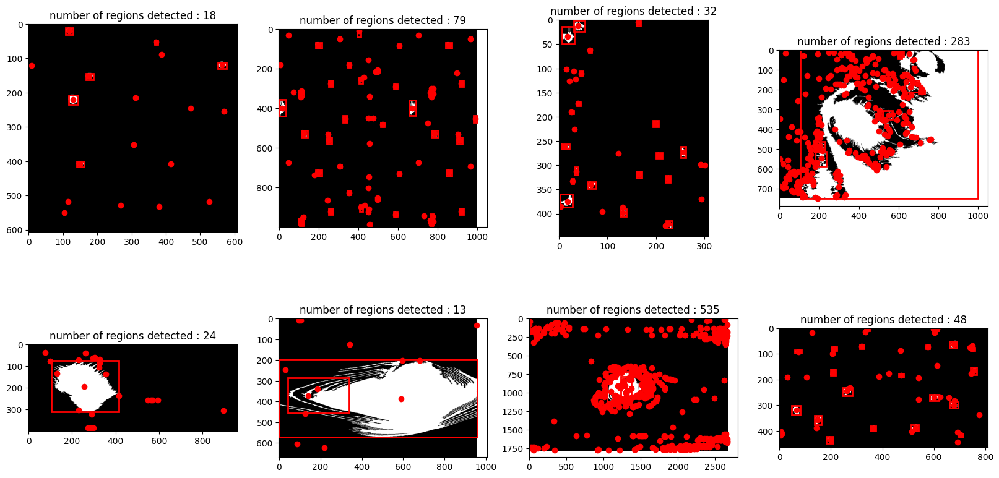

In [12]:
fig, ax = plt.subplots(2, 4,figsize = (20,10))

for i in range(data_size):
    labeled_regions, num_labels = sk.measure.label(data_fill2[i], return_num=True)
    
    region_props = sk.measure.regionprops(labeled_regions)
    
    filtered_regions = [
        region.label
        for region in region_props
        if region.area > 5 and region.eccentricity < 0.9
    ]
    
    centroids = [region.centroid 
                 for region in region_props
                 if region.area > 5 and region.eccentricity < 0.9]
    bounding_boxes = [region.bbox 
                      for region in region_props
                      if region.area > 5 and region.eccentricity < 0.9]
    
    filtered_image = np.isin(labeled_regions, filtered_regions)

    
    ax.flatten()[i].imshow(filtered_image, cmap='gray')
    ax.flatten()[i].set_title(f"number of regions detected : {len(filtered_regions)}")
    for centroid, bbox in zip(centroids, bounding_boxes):
                y, x = centroid
                minr, minc, maxr, maxc = bbox
                rect = plt.Rectangle((minc, minr), maxc - minc, maxr - minr, fill=False, edgecolor='red', linewidth=2)
                ax.flatten()[i].add_patch(rect)
                ax.flatten()[i].plot(x, y,'ro')


On remarque que cette approche n'a pas rendu la méthode parfaite mais à réussi à améliorer la détection des noeuds sur certaines images, en effet sur les images avec des gros noeuds on détecte moins de faux positifs. Cette méthode pourrais alors être fusionnée avec une autre méthode pour réduire encore plus les faux positifs.

# Nouvelle methode : Separation des couleurs

Dans cette nouvelle partie nous allons essayer de separer pour chaque image les niveaux de marrons; on remarque que chaque noeud a une couleur marron plus "foncée" que le reste de l'image en general. 



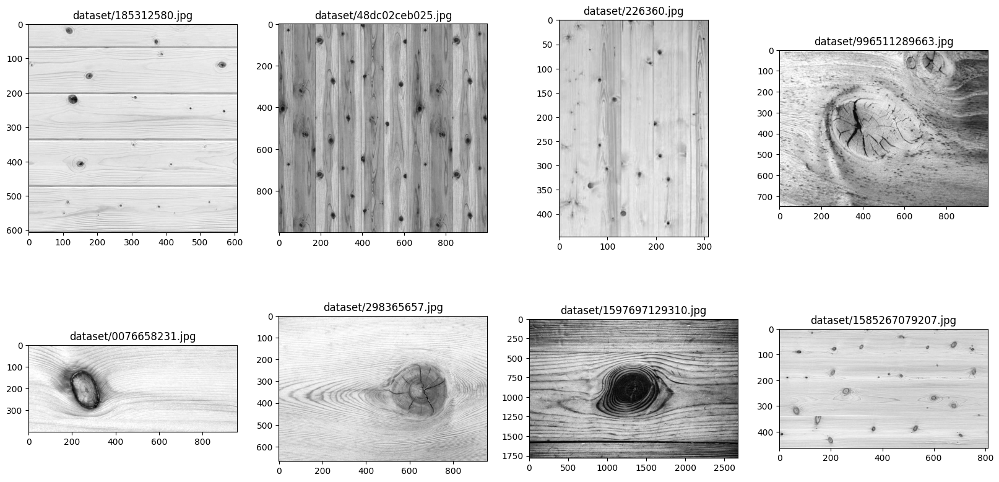

In [13]:
fig, ax = plt.subplots(2, 4,figsize = (20,10))



for i in range(data_size) : 
    # Extract the brown color channel
    data_brown[i] = io.imread(data[i])[:, :, 0]
    ax.flatten()[i].imshow((data_brown[i]),cmap = 'gray')
    ax.flatten()[i].set_title((data[i]))



    

  

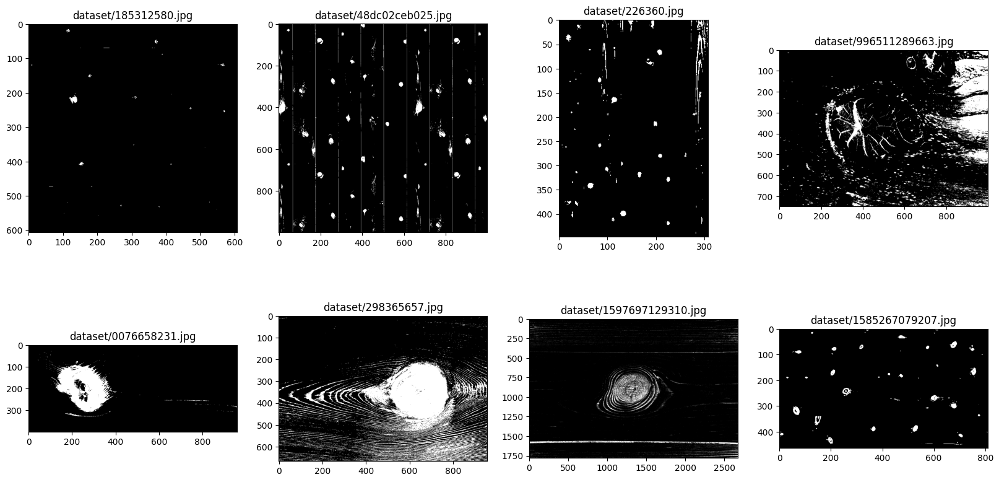

In [14]:
fig, ax = plt.subplots(2, 4,figsize = (20,10))
t_test[0] = sk.filters.threshold_yen(data_brown[0])
t_test[1] = sk.filters.threshold_yen(data_brown[1])
t_test[2] = sk.filters.threshold_triangle(data_brown[2])
t_test[3] = sk.filters.threshold_yen(data_brown[3])
t_test[4] = sk.filters.threshold_yen(data_brown[4])
t_test[5] = sk.filters.threshold_otsu(data_brown[5])
t_test[6] = sk.filters.threshold_minimum(data_brown[6])
t_test[7] = sk.filters.threshold_yen(data_brown[7])

for i in range(data_size):
    data_threshold2[i] = data_brown[i] < t_test[i]
    ax.flatten()[i].imshow((data_threshold2[i]),cmap = 'gray')
    ax.flatten()[i].set_title((data[i]))

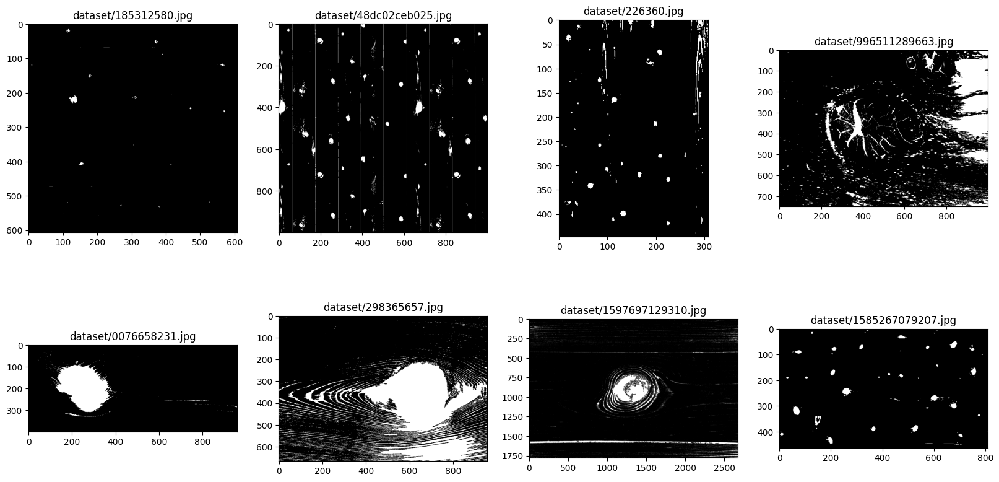

In [15]:
fig, ax = plt.subplots(2, 4,figsize = (20,10))
for i in range(data_size):
    data_fill2[i] = sc.ndimage.binary_fill_holes(data_threshold2[i])
    ax.flatten()[i].imshow((data_fill2[i]),cmap = 'gray')
    ax.flatten()[i].set_title((data[i]))

Pour chaque image, on appliquera ou non un procédé d'érosion, dilatation, ouverture ou fermeture comme vu en cours afin d'essayer d'avoir un meilleur resultat post traitement.

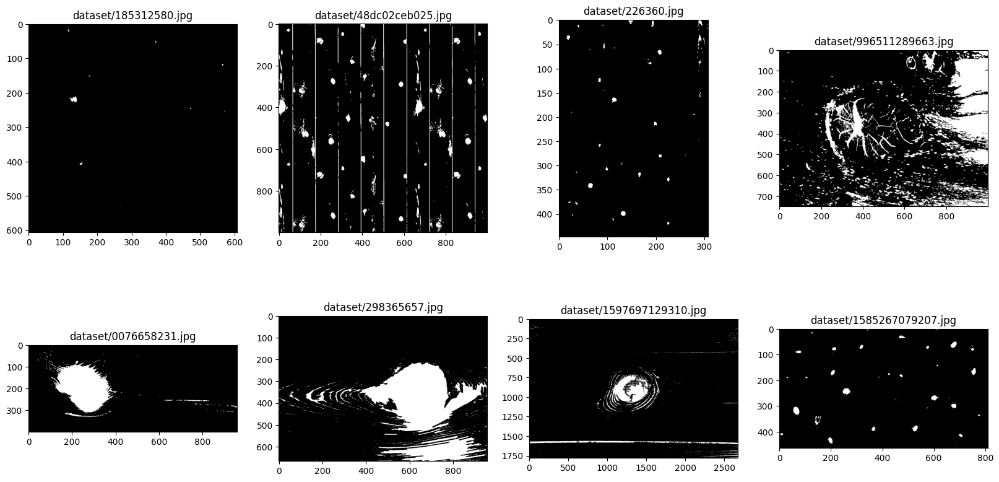

In [16]:
data_binary = [None] * data_size

data_binary[0] = sk.morphology.binary_erosion(data_fill2[0])
data_binary[1] = sk.morphology.binary_dilation(data_fill2[1])
data_binary[2] = sk.morphology.binary_erosion(data_fill2[2])
data_binary[3] = sk.morphology.binary_dilation(data_fill2[3])
data_binary[4] = sk.morphology.binary_dilation(data_fill2[4])
data_binary[5] = sk.morphology.binary_erosion(data_fill2[5])
data_binary[6] = sk.morphology.binary_opening(data_fill2[6])
data_binary[7] = sk.morphology.binary_erosion(data_fill2[7])

    
fig, ax = plt.subplots(2, 4,figsize = (20,10))
for i in range(data_size):
    ax.flatten()[i].imshow((data_binary[i]),cmap = 'gray')
    ax.flatten()[i].set_title((data[i]))
    
    



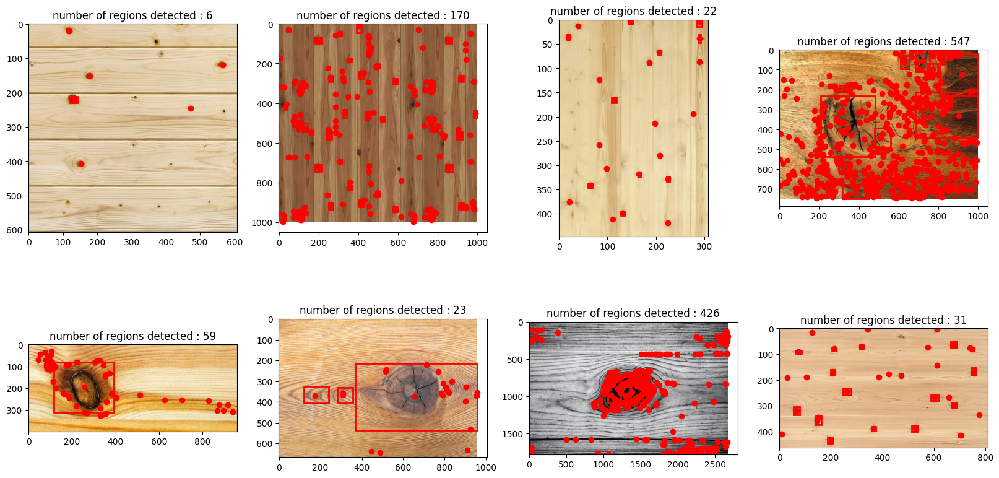

In [17]:
fig, ax = plt.subplots(2, 4,figsize = (20,10))

for i in range(data_size):
    labeled_regions, num_labels = sk.measure.label(data_binary[i], return_num=True)
    
    region_props = sk.measure.regionprops(labeled_regions)
    
    filtered_regions = [
        region.label
        for region in region_props
        if region.area > 5 and region.eccentricity < 0.9
    ]
    
    centroids = [region.centroid 
                 for region in region_props
                 if region.area > 5 and region.eccentricity < 0.9]
    bounding_boxes = [region.bbox 
                      for region in region_props
                      if region.area > 5 and region.eccentricity < 0.9]
    
    filtered_image = np.isin(labeled_regions, filtered_regions)

    original_image = data[i]
    ax.flatten()[i].imshow(io.imread(original_image), cmap='gray')
    ax.flatten()[i].set_title(f"number of regions detected : {len(filtered_regions)}")
    
    #ax.flatten()[i].imshow(filtered_image, cmap='gray')
    #ax.flatten()[i].set_title(f"number of regions detected : {len(filtered_regions)}")
    for centroid, bbox in zip(centroids, bounding_boxes):
                y, x = centroid
                minr, minc, maxr, maxc = bbox
                rect = plt.Rectangle((minc, minr), maxc - minc, maxr - minr, fill=False, edgecolor='red', linewidth=2)
                ax.flatten()[i].add_patch(rect)
                ax.flatten()[i].plot(x, y,'ro')


# Résultats de la séparation des couleurs

On remarque que le fait de n'afficher que le rouge sur l'image a aider a isoler les noeuds et a amélioré considérablement les résultats. 

Nous allons maintenant essayer de jouer sur les formes des noeuds pour arriver à isoler les noeuds solitaires. 

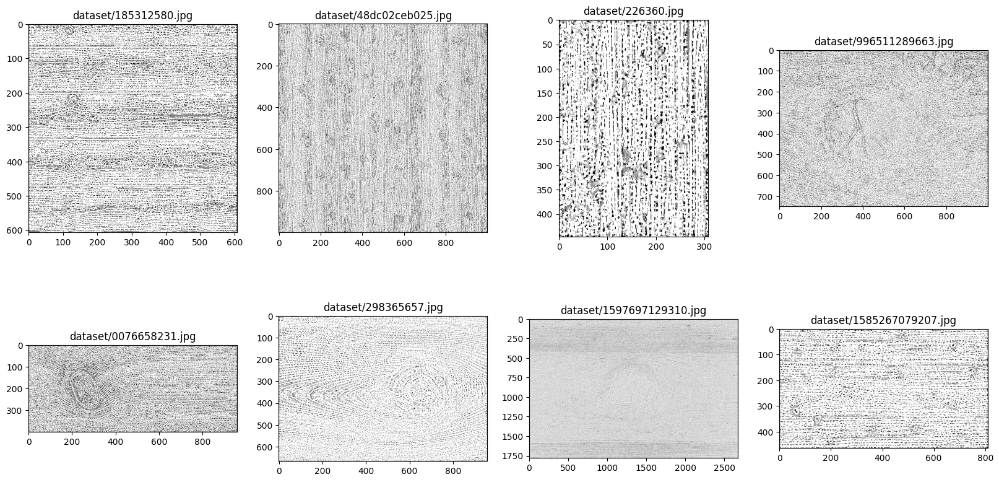

In [18]:
fig, ax = plt.subplots(2, 4,figsize = (20,10))

radius = 3
radius1 = 3
radius2 = 5
radius3 = 3
radius4 = 3 
radius5 = 5
radius6 = 3
radius7 = 5

n_points = 30 * radius
n_points1 = 30 * radius1
n_points2= 35 * radius2
n_points3 = 30 * radius3
n_points4 = 30 * radius4
n_points5 = 40 * radius5
n_points6 = 30 * radius6
n_points7 = 40 * radius7
lbp_image = [None] * data_size



data_brown[0] = io.imread(data[0])[:, :, 0]
lbp_image[0] = sk.feature.local_binary_pattern(data_brown[0], n_points, radius, method='uniform')

data_brown[1] = io.imread(data[1])[:, :, 0]
lbp_image[1] = sk.feature.local_binary_pattern(data_brown[1], n_points1, radius1, method='uniform')

data_brown[2] = io.imread(data[2])[:, :, 0]
lbp_image[2] = sk.feature.local_binary_pattern(data_brown[2], n_points2, radius2, method='uniform')

data_brown[3] = io.imread(data[3])[:, :, 0]
lbp_image[3] = sk.feature.local_binary_pattern(data_brown[3], n_points3, radius3, method='uniform')

data_brown[4] = io.imread(data[4])[:, :, 0]
lbp_image[4] = sk.feature.local_binary_pattern(data_brown[4], n_points4, radius4, method='uniform')

data_brown[5] = io.imread(data[5])[:, :, 0]
lbp_image[5] = sk.feature.local_binary_pattern(data_brown[5], n_points5, radius5, method='uniform')

data_brown[6] = io.imread(data[6])[:, :, 0]
lbp_image[6] = sk.feature.local_binary_pattern(data_brown[6], n_points6, radius6, method='uniform')

data_brown[7] = io.imread(data[7])[:, :, 0]
lbp_image[7] = sk.feature.local_binary_pattern(data_brown[7], n_points7, radius7, method='uniform')

for i in range(data_size):
    ax.flatten()[i].imshow((lbp_image[i]),cmap = 'gray')
    ax.flatten()[i].set_title((data[i]))





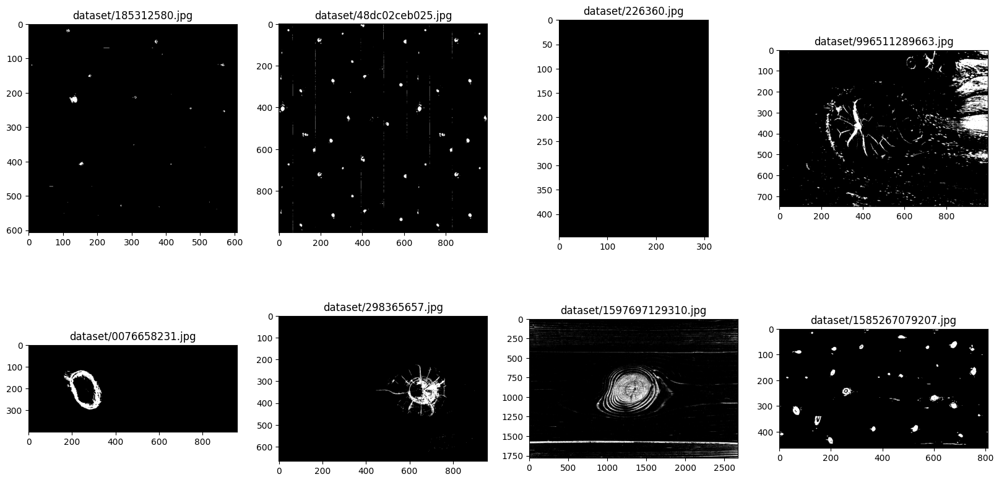

In [19]:
fig, ax = plt.subplots(2, 4,figsize = (20,10))
t_test[0] = sk.filters.threshold_yen(lbp_image[0])
t_test[1] = sk.filters.threshold_yen(lbp_image[1])
t_test[2] = sk.filters.threshold_isodata(lbp_image[2])
t_test[3] = sk.filters.threshold_yen(lbp_image[3])
t_test[4] = sk.filters.threshold_yen(lbp_image[4])
t_test[5] = sk.filters.threshold_otsu(lbp_image[5])
t_test[6] = sk.filters.threshold_minimum(lbp_image[6])
t_test[7] = sk.filters.threshold_yen(lbp_image[7])

for i in range(data_size):
    data_threshold2[i] = data_brown[i] < t_test[i]
    ax.flatten()[i].imshow((data_threshold2[i]),cmap = 'gray')
    ax.flatten()[i].set_title((data[i]))

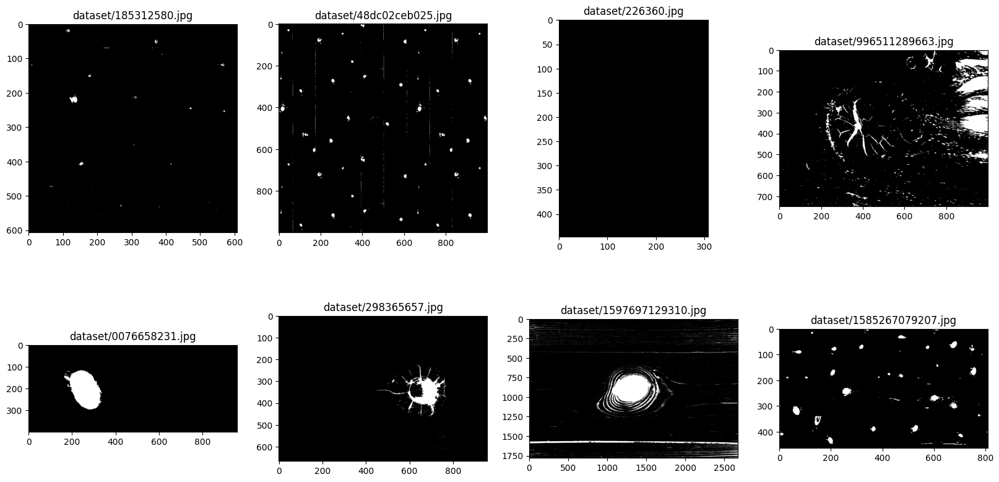

In [20]:
fig, ax = plt.subplots(2, 4,figsize = (20,10))
for i in range(data_size):
    data_fill2[i] = sc.ndimage.binary_fill_holes(data_threshold2[i])
    ax.flatten()[i].imshow((data_fill2[i]),cmap = 'gray')
    ax.flatten()[i].set_title((data[i]))

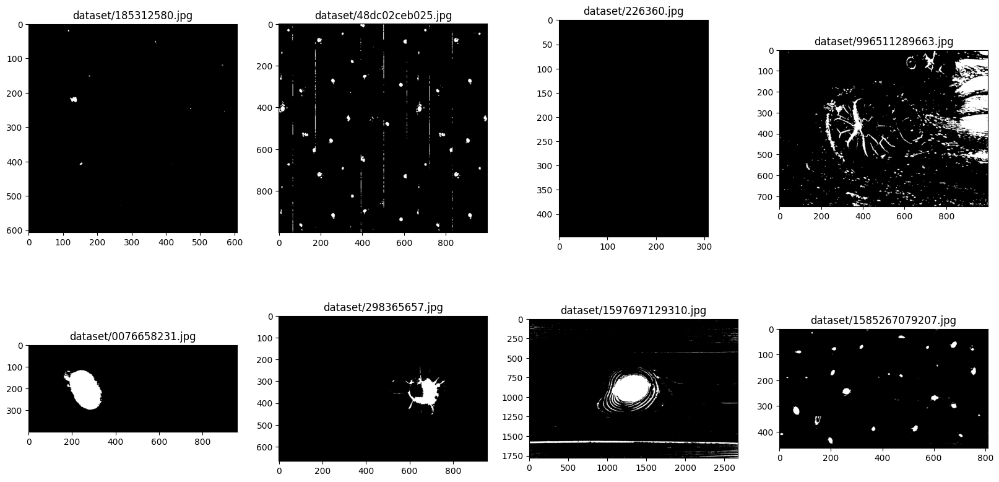

In [21]:
data_binary = [None] * data_size

data_binary[0] = sk.morphology.binary_erosion(data_fill2[0])
data_binary[1] = sk.morphology.binary_dilation(data_fill2[1])
data_binary[2] = sk.morphology.binary_erosion(data_fill2[2])
data_binary[3] = sk.morphology.binary_dilation(data_fill2[3])
data_binary[4] = sk.morphology.binary_dilation(data_fill2[4])
data_binary[5] = sk.morphology.binary_erosion(data_fill2[5])
data_binary[6] = sk.morphology.binary_opening(data_fill2[6])
data_binary[7] = sk.morphology.binary_erosion(data_fill2[7])



    
fig, ax = plt.subplots(2, 4,figsize = (20,10))
for i in range(data_size):
    ax.flatten()[i].imshow((data_binary[i]),cmap = 'gray')
    ax.flatten()[i].set_title((data[i]))

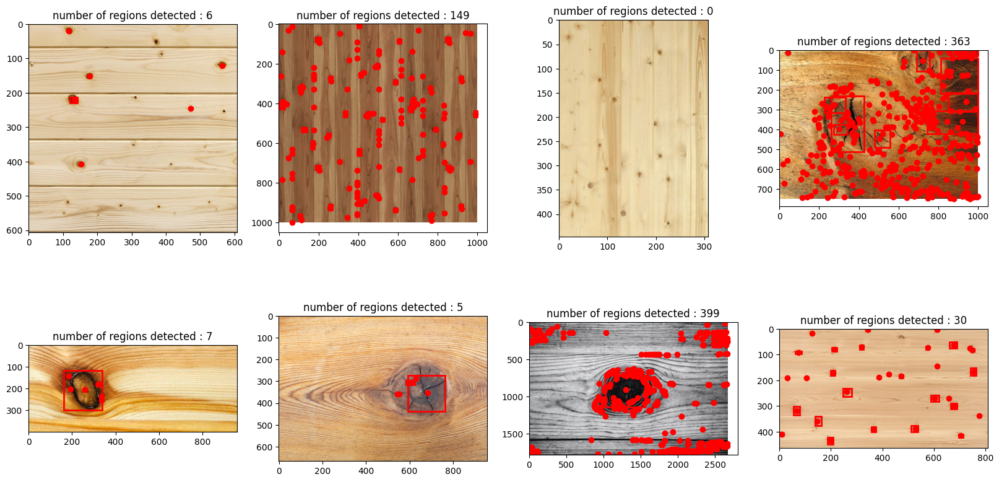

In [22]:
fig, ax = plt.subplots(2, 4,figsize = (20,10))
#on filtre la 3e image : 
labeled_image, num_features = sk.measure.label(data_binary[2], connectivity=2, return_num=True)
region_props = sk.measure.regionprops(labeled_image)
filtered_regions = [region for region in region_props if region.area > 30000]
data_binary[2] = np.isin(labeled_image, [region.label for region in filtered_regions])






for i in range(data_size):
    labeled_regions, num_labels = sk.measure.label(data_binary[i], return_num=True)
    
    region_props = sk.measure.regionprops(labeled_regions)
    
    filtered_regions = [
        region.label
        for region in region_props
        if region.area > 5 and region.eccentricity < 0.9
    ]
    
    centroids = [region.centroid 
                 for region in region_props
                 if region.area > 5 and region.eccentricity < 0.9]
    bounding_boxes = [region.bbox 
                      for region in region_props
                      if region.area > 5 and region.eccentricity < 0.9]
    
    filtered_image = np.isin(labeled_regions, filtered_regions)

    original_image = data[i]
    ax.flatten()[i].imshow(io.imread(original_image), cmap='gray')
    ax.flatten()[i].set_title(f"number of regions detected : {len(filtered_regions)}")
    
    #ax.flatten()[i].imshow(filtered_image, cmap='gray')
    #ax.flatten()[i].set_title(f"number of regions detected : {len(filtered_regions)}")
    for centroid, bbox in zip(centroids, bounding_boxes):
                y, x = centroid
                minr, minc, maxr, maxc = bbox
                rect = plt.Rectangle((minc, minr), maxc - minc, maxr - minr, fill=False, edgecolor='red', linewidth=2)
                ax.flatten()[i].add_patch(rect)
                ax.flatten()[i].plot(x, y,'ro')


On remarque que chaque image devrait avoir une valeur de rayon et de nombre de points differents. 

Maintenant, on remarque que la derniere image pose problème.  

# ALGORITHME FINAL

- filtrer la couleur de chaque dans le rouge [:,:,0] afin d'ameliorer de base la robustesse de l'algorithme final comme nous l'avons vu auparavant.

- Pour les images contenant de gros noeuds, appliquer le [LPB](https://www.researchgate.net/publication/332834746_Detection_of_various_characteristics_on_wooden_surfaces_using_scanner_and_image_processing_techniques)[1]


- appliquer un threshold propre a chacune des images, choisit auparavant

- Remplir les trous grace a binary_fill_holes

- Appliquer un changement de "morphology" a l'image 

- Appliquer l'algorithme final pour afficher les bounding boxes et centroids. 


# 1-Filtrage de couleur

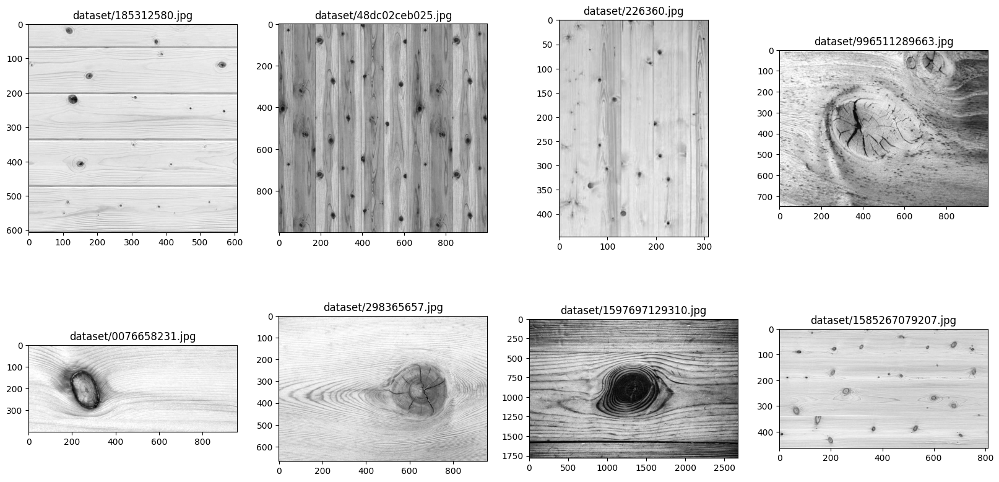

In [23]:
# Création d'une grille de sous-graphiques 2x4 avec une taille de figure de (20, 10)
fig, ax = plt.subplots(2, 4, figsize=(20, 10))

# Boucle sur un ensemble d'images (data)
for i in range(data_size):

    # Charger l'image et extraire le canal de couleur marron (canal 0)
    data_brown[i] = io.imread(data[i])[:, :, 0]
    
    # Afficher l'image en niveaux de gris dans le sous-graphique correspondant
    ax.flatten()[i].imshow(data_brown[i], cmap='gray')
    
    # Définir le titre du sous-graphique avec le nom de l'image
    ax.flatten()[i].set_title(data[i])

# 2-LPB (Gros noeuds)

Remarque : les noeuds sont deja beaucoup plus visibles que sur les images originales. 

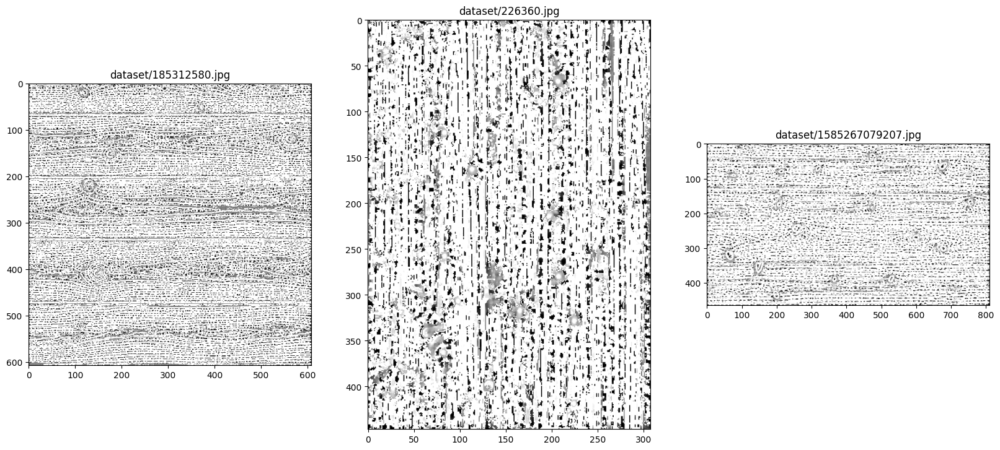

In [24]:
# Création d'une grille de sous-graphiques 2x4 avec une taille de figure de (20, 10)
fig, ax = plt.subplots(1, 3, figsize=(20, 10))

# Définition des paramètres pour la méthode LBP
radius = 3
radius2 = 5
radius7 = 5

n_points = 30 * radius
n_points2 = 35 * radius2
n_points7 = 40 * radius7

# Initialisation des listes pour les images LBP et les canaux marron
lbp_image = [None] * data_size

# Chargement de la première image et calcul de son LBP
lbp_image[0] = sk.feature.local_binary_pattern(data_brown[0], n_points, radius, method='uniform')

lbp_image[2] = sk.feature.local_binary_pattern(data_brown[2], n_points2, radius2, method='uniform')

lbp_image[7] = sk.feature.local_binary_pattern(data_brown[7], n_points7, radius7, method='uniform')

#Affichage des 3 images LPB des gros noeuds
ax.flatten()[0].imshow(lbp_image[0], cmap='gray')
ax.flatten()[0].set_title(data[0])
ax.flatten()[1].imshow(lbp_image[2], cmap='gray')
ax.flatten()[1].set_title(data[2])
ax.flatten()[2].imshow(lbp_image[7], cmap='gray')
ax.flatten()[2].set_title(data[7])

#On remplit la liste avec les images non modifiées
lbp_image[1] = data_brown[1]
lbp_image[3] = data_brown[3]
lbp_image[4] = data_brown[4]
lbp_image[5] = data_brown[5]
lbp_image[6] = data_brown[6]

# 3-Application d'un threshold determiné

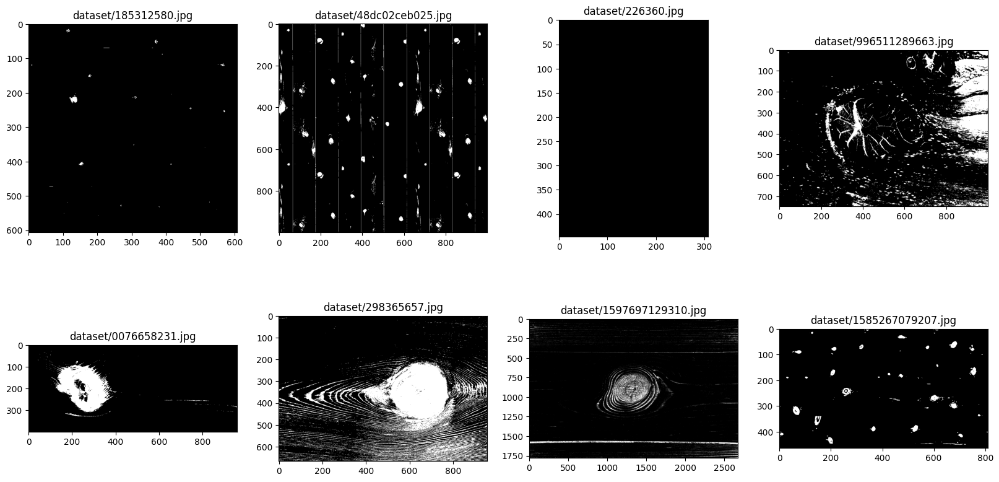

In [25]:
fig, ax = plt.subplots(2, 4,figsize = (20,10))

#t_test : liste contenant les threshold des différentes images
t_test[0] = sk.filters.threshold_yen(lbp_image[0])
t_test[1] = sk.filters.threshold_yen(lbp_image[1])
t_test[2] = sk.filters.threshold_isodata(lbp_image[2])
t_test[3] = sk.filters.threshold_yen(lbp_image[3])
t_test[4] = sk.filters.threshold_yen(lbp_image[4])
t_test[5] = sk.filters.threshold_otsu(lbp_image[5])
t_test[6] = sk.filters.threshold_minimum(lbp_image[6])
t_test[7] = sk.filters.threshold_yen(lbp_image[7])

#Affichage
for i in range(data_size):
    data_threshold2[i] = data_brown[i] < t_test[i]
    ax.flatten()[i].imshow((data_threshold2[i]),cmap = 'gray')
    ax.flatten()[i].set_title((data[i]))

# 4-Remplissage des trous

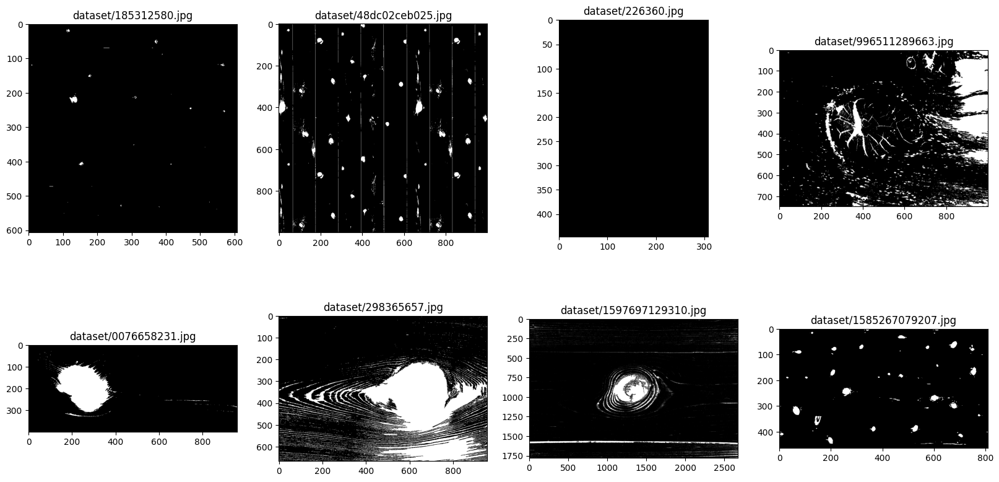

In [26]:
fig, ax = plt.subplots(2, 4,figsize = (20,10))
for i in range(data_size):
    data_fill2[i] = sc.ndimage.binary_fill_holes(data_threshold2[i])
    ax.flatten()[i].imshow((data_fill2[i]),cmap = 'gray')
    ax.flatten()[i].set_title((data[i]))

# 5-Changement de "morphology"

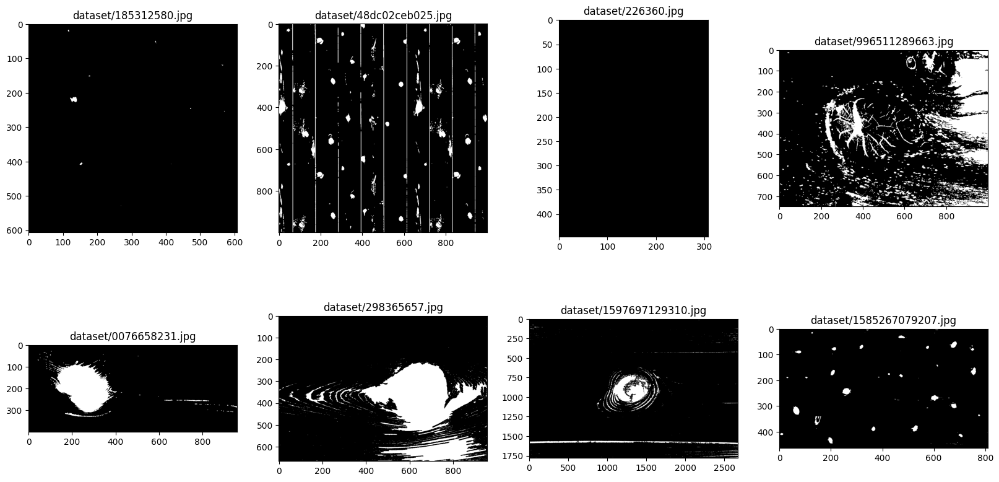

In [27]:
data_binary = [None] * data_size

data_binary[0] = sk.morphology.binary_erosion(data_fill2[0])
data_binary[1] = sk.morphology.binary_dilation(data_fill2[1])
data_binary[2] = sk.morphology.binary_erosion(data_fill2[2])
data_binary[3] = sk.morphology.binary_dilation(data_fill2[3])
data_binary[4] = sk.morphology.binary_dilation(data_fill2[4])
data_binary[5] = sk.morphology.binary_erosion(data_fill2[5])
data_binary[6] = sk.morphology.binary_opening(data_fill2[6])
data_binary[7] = sk.morphology.binary_erosion(data_fill2[7])



    
fig, ax = plt.subplots(2, 4,figsize = (20,10))
for i in range(data_size):
    ax.flatten()[i].imshow((data_binary[i]),cmap = 'gray')
    ax.flatten()[i].set_title((data[i]))

# 6-Finalisation : Affichage des centroids et bounding boxes

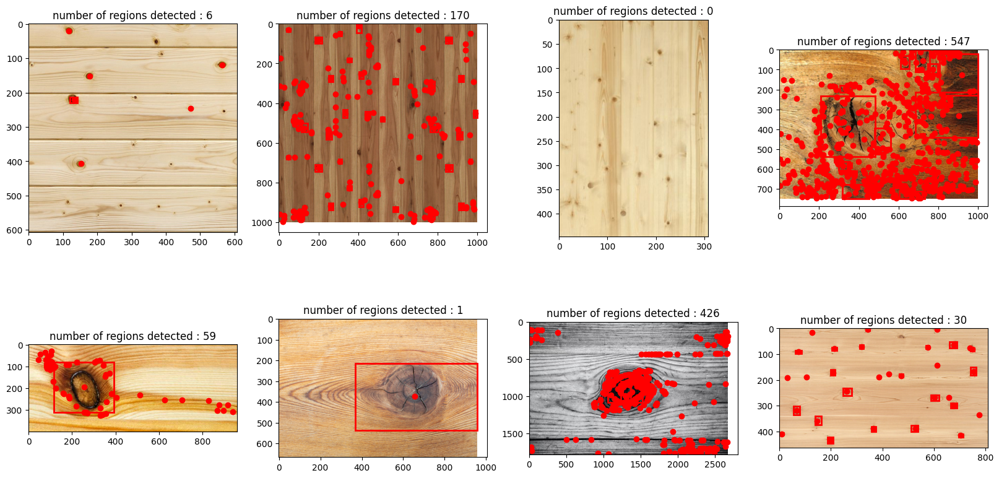

In [28]:
fig, ax = plt.subplots(2, 4,figsize = (20,10))
#on filtre la 3e image : 
labeled_image, num_features = sk.measure.label(data_binary[2], connectivity=2, return_num=True)
region_props = sk.measure.regionprops(labeled_image)
filtered_regions = [region for region in region_props if region.area > 30000]
data_binary[2] = np.isin(labeled_image, [region.label for region in filtered_regions])

labeled_image, num_features = sk.measure.label(data_binary[5], connectivity=2, return_num=True)
region_props = sk.measure.regionprops(labeled_image)
filtered_regions = [region for region in region_props if region.area > 3000]
data_binary[5] = np.isin(labeled_image, [region.label for region in filtered_regions])






for i in range(data_size):
    labeled_regions, num_labels = sk.measure.label(data_binary[i], return_num=True)
    
    region_props = sk.measure.regionprops(labeled_regions)
    
    filtered_regions = [
        region.label
        for region in region_props
        if region.area > 5 and region.eccentricity < 0.9
    ]
    
    centroids = [region.centroid 
                 for region in region_props
                 if region.area > 5 and region.eccentricity < 0.9]
    bounding_boxes = [region.bbox 
                      for region in region_props
                      if region.area > 5 and region.eccentricity < 0.9]
    
    filtered_image = np.isin(labeled_regions, filtered_regions)

    original_image = data[i]
    ax.flatten()[i].imshow(io.imread(original_image), cmap='gray')
    ax.flatten()[i].set_title(f"number of regions detected : {len(filtered_regions)}")
    
    #ax.flatten()[i].imshow(filtered_image, cmap='gray')
    #ax.flatten()[i].set_title(f"number of regions detected : {len(filtered_regions)}")
    for centroid, bbox in zip(centroids, bounding_boxes):
                y, x = centroid
                minr, minc, maxr, maxc = bbox
                rect = plt.Rectangle((minc, minr), maxc - minc, maxr - minr, fill=False, edgecolor='red', linewidth=2)
                ax.flatten()[i].add_patch(rect)
                ax.flatten()[i].plot(x, y,'ro')


# 7-Conclusion
- La methode apportée par le LPB nous a fournit une avancée exceptionelle pour la détection de neouds de taille supérieure. Pour les images contenant de nombreux noeuds de petite taille, l'algorithme a pu tous les reconnaitre heureusement, malgré un nombre tres faible de faux positifs. 

- Cependant, la derniere image presentant trois noeuds dont un gros au milieu et deux petits en haut a posé beaucoup de difficultés. Rien que visuellement, on peut remarquer que les nuances de marrons sont nombreuses, claires comme sombre et cela a posé des contraintes dors et déjà pour le filtrage des couleurs qui ne servait donc à pas grand chose.
De plus, les noeuds de cette image présentaient des "fissures" qui rendaient la detection encore plus compliquée, et finalement le "contour" du noeud n'etait pas très tracé. 

# 8-Des méthodes plus efficaces
Nous voyons que malgré les améliorations apportées, nous n'avons toujours pas de prédiction parfaite. Nous avons donc recherché d'autres méthodes pour nous aider. Nous ne sommes tombés que sur des projets utilisant l'intelligence artificielle, et pour cause : quelle que soit la méthode, nous serons toujours éloignés de la ground truth. Dans un premier temps, pour nous rendre compte de la puissance de tels outils, nous avons essayé de trouver les nœuds dans les images grâce à [Segment anything](https://segment-anything.com/demo) de Meta et ses différents outils. Nous avons obtenu des résultats très rapides et très satisfaisants, notamment lorsque les images n'avaient que quelques gros nœuds. Nous nous sommes aussi penchés sur le document "[Detection of Knots in Oak Wood Planks: Instance versus Semantic segmentation](https://ieeexplore-ieee-org.scd-rproxy.u-strasbg.fr/document/9862633)"[2] qui étudie la différence de performance entre deux méthodes de détection de nœuds. On y apprend que différents modèles pour les IA (SSD, Mask R-CNN, YOLO...) ont été utilisés, mais que, que ce soit la méthode de segmentation d'instance ou sémantique, on atteint une précision entre 89% et 90% sur la détection de nœuds. Néanmoins, on observe une faible précision sur la détection des bounding boxes (entre 49% et 59%).

Malgré la performance de ces modèles, il faut noter que pour les créer, il faut d'abord un jeu de données avec les ground-truth des images pour l'apprentissage. Cela implique ici de faire une détection des nœuds de notre jeu de données à la main


# 9-Références
[1]Barmpoutis, Panagiotis & Barboutis, Ioannis (John) & Lefakis, Panagiotis. (2019). Detection of various characteristics on wooden surfaces, using scanner and image processing techniques.

[2]E. Urtans et al., "Detection of Knots in Oak Wood Planks: Instance versus Semantic segmentation," 2022 IEEE 5th International Conference on Big Data and Artificial Intelligence (BDAI), Fuzhou, China, 2022, pp. 163-168, doi: 10.1109/BDAI56143.2022.9862633.